# Library loading

In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from scipy import sparse
from anndata import AnnData
import warnings
import socket
import holoviews as hv
import plotly.express as px
import random
import itertools
from matplotlib import pylab
import sys
import yaml
import os
from pandas.api.types import CategoricalDtype
import plotly
import scvelo as scv

random.seed(0)

import matplotlib.pyplot as plt

warnings.filterwarnings('ignore')

In [2]:
plotly.offline.init_notebook_mode()

In [3]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging


In [4]:
import ipynbname
try:
    nb_fname = ipynbname.name()
except:
    nb_fname = "".join(os.path.basename(globals()["__vsc_ipynb_file__"]).split(".")[:-1])

In [5]:
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [6]:
anndata2ri.activate()

In [7]:
%load_ext rpy2.ipython

In [8]:
%%R
library(miloR)
library(igraph)
set.seed(0)

In [9]:
%matplotlib inline

In [10]:
sc.settings.verbosity = 3         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=50, facecolor='white', dpi_save=500)
pylab.rcParams['figure.figsize'] = (9, 9)
outBaseName = "04.1A_Neurons_DA"
figDir = "./figures"


scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.13.1 python-igraph==0.9.8 louvain==0.7.1 pynndescent==0.5.5


### Configure paths

In [11]:
hostRoot = "-".join(socket.gethostname().split('-')[0:2])

#indir=paths["paths"]["indir"][hostRoot]
outdir="./outdir"


leiden3Mapping = {"0":"Encs-1",
"1":"CBC/BRCs-1",
"2":"EXN-1",
"3":"EnCs-2",
"4":"RGCs-1",
"5":"RGCs-2",
"6":"ccRGCs",
"7":"inPCs",
"8":"EXN-2",
"9":"RtCs",
"10":"ER-Cs",
"11":"CBC/BRCs-2"}

In [12]:
adata = sc.read_h5ad(outdir+"/3_polaroid_quickAnno.h5ad")

adata.obs["leidenAnno"] =  adata.obs["leiden0.3"].replace(leiden3Mapping).astype("category").cat.reorder_categories(list(leiden3Mapping.values()))
adata.uns["leidenAnno_colors"] = adata.uns["leiden0.3_colors"].copy()

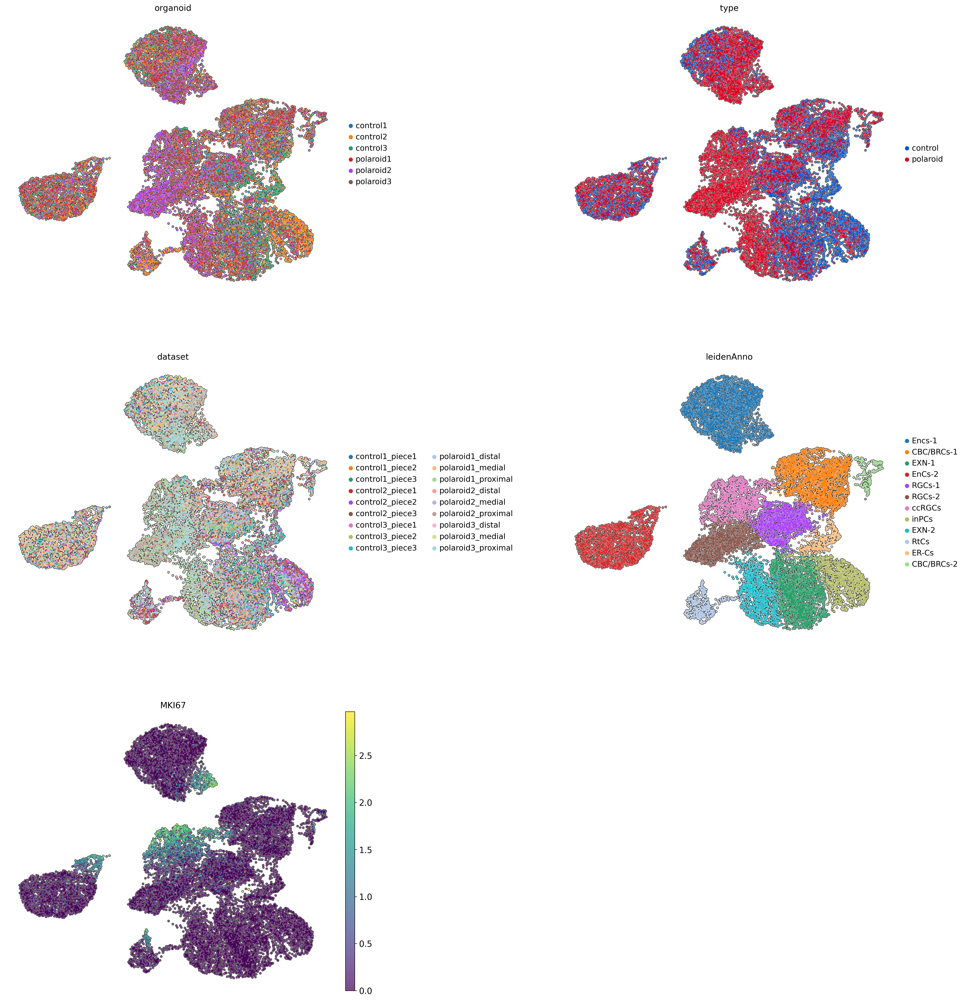

In [13]:
pylab.rcParams['figure.figsize'] = (9, 9)

sc.pl.umap(adata, color=["organoid","type","dataset","leidenAnno","MKI67"],
            ncols = 2, size = 30, add_outline = True,
           outline_width=(0.2, 0.05), frameon=False, wspace=.5)

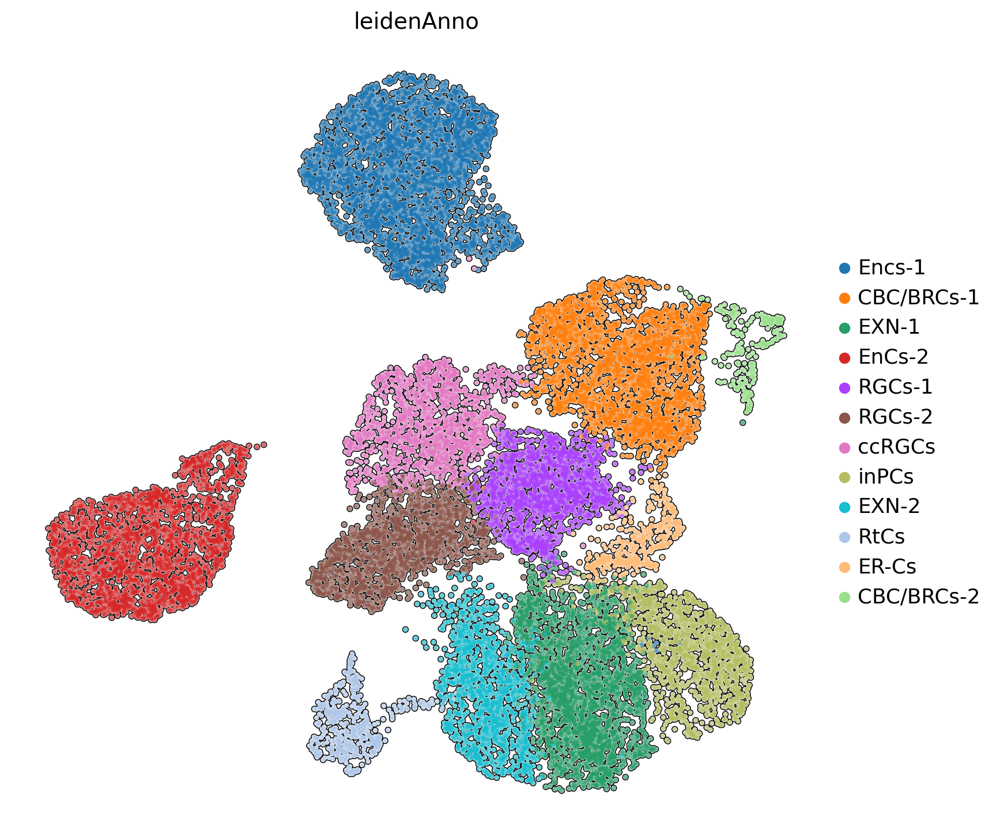

In [14]:
pylab.rcParams['figure.figsize'] = (9, 9)

sc.pl.umap(adata, color=["leidenAnno"],
            ncols = 2, size = 30, add_outline = True,
           outline_width=(0.2, 0.05), frameon=False, wspace=.5, save="UMAP_ALL_ANNOTATED.pdf")

# Prepare contrasts col

In [15]:
adata.obs["regionContrast"] = adata.obs["region"]
adata.obs["regionContrast"] = adata.obs["regionContrast"].replace({"piece2":"control","piece1":"control","piece3":"control"})

In [16]:
adata.obs["regionContrast"].value_counts()

control     8194
proximal    6093
medial      3019
distal      1516
Name: regionContrast, dtype: int64

# Proximal vs Distal

In [17]:
#Adata
adata_no_knn_all = adata.copy()
ssBy = "region"
restrictOBS = {"region":["proximal","distal"]}

# Subset adata to match equal n cells by region


adata_no_knn_all  = adata_no_knn_all[list(set.intersection(*[set(adata_no_knn_all.obs_names[adata_no_knn_all.obs[k].isin(restrictOBS[k])].tolist()) for k in list(restrictOBS.keys())]))]
TargetCells = adata_no_knn_all.obs[ssBy].value_counts().min()
nl = [random.sample(adata_no_knn_all.obs_names[adata_no_knn_all.obs[ssBy] == d].tolist(),TargetCells) for d in adata_no_knn_all.obs[ssBy].unique()]
adata_no_knn_all = adata_no_knn_all[[item for sublist in nl for item in sublist]].copy()

print(adata_no_knn_all.obs[ssBy].value_counts())

adata_no_knn_all.obsp = None
adata_no_knn_all.uns.pop("neighbors")
#adata_no_knn_all.X = adata_no_knn_all.X.todense()

for c in ["organoid","type","regionContrast"]:
    adata_no_knn_all.obs[c] = adata_no_knn_all.obs[c].astype("category")


# DesignMAtrix
design_df = adata_no_knn_all.obs[["dataset","type","regionContrast"]]
design_df.drop_duplicates(inplace=True)
design_df.index = design_df['dataset']
design_df

distal      1516
proximal    1516
Name: region, dtype: int64


,dataset,type,regionContrast
dataset,,,
polaroid2_proximal,polaroid2_proximal,polaroid,proximal
polaroid1_proximal,polaroid1_proximal,polaroid,proximal
polaroid3_proximal,polaroid3_proximal,polaroid,proximal
polaroid1_distal,polaroid1_distal,polaroid,distal
polaroid3_distal,polaroid3_distal,polaroid,distal
polaroid2_distal,polaroid2_distal,polaroid,distal


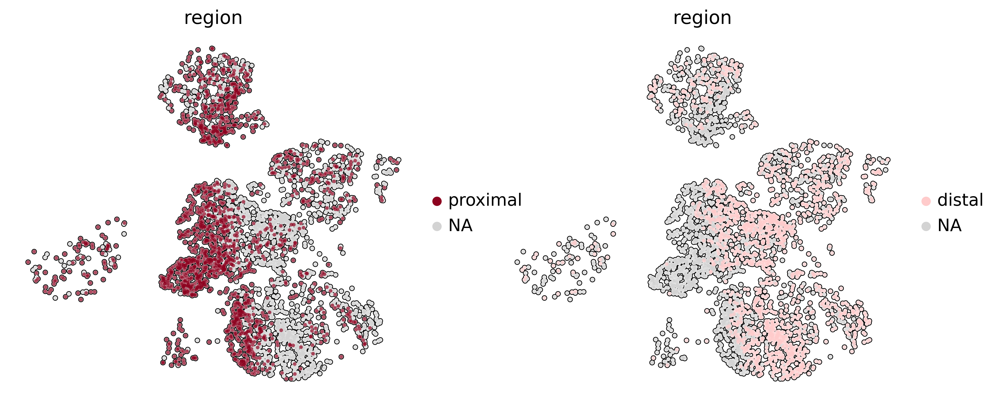

In [17]:
fig, axs = plt.subplots(1,2,figsize=(12, 5) )

for axi, reg in zip(axs.flatten(), adata_no_knn_all.obs.region.unique()):   
    sc.pl.umap(adata_no_knn_all, color=["region"] , groups=reg,  size = 30, 
               add_outline = True,outline_width=(0.2, 0.05), frameon=False, show=False, ax=axi)

In [19]:
%%R -i adata_no_knn_all

d=20
k=15

set.seed(0)

milo <- Milo(adata_no_knn_all)
milo <- buildGraph(milo, k=k, d=d)


In [20]:
%%R -i design_df -o DA_results_Prox_vs_Dist  -o nhoods_all
set.seed(0)

design_df$type <- as.factor(design_df$type)
design_df$regionContrast <- as.factor(design_df$regionContrast)
design_df$dataset <- as.factor(design_df$dataset)

contrastProx_vs_Dist <- c("regionContrastproximal - regionContrastdistal")

#contrastAll <- c("regionContrastproximal - regionContrastdistal")
#contrastAll <- c("regionContrastproximal - regionContrastdistal")



## Define neighbourhoods
milo <- makeNhoods(milo, prop = 1, k = k, d=d, refined = TRUE)

## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="dataset")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=d)

## Test for differential abundance

nhoods_all <- milo@nhoods


DA_results_Prox_vs_Dist <- testNhoods(milo, design = ~ 0 + regionContrast, design.df = design_df, model.contrast = contrastProx_vs_Dist)


#DA_results_all <- testNhoods(milo, design = ~ 0 + type, design.df = design_df, model.contrast = contrastPol_vs_CTL)



In [21]:
%%R
set.seed(0)

milo <- buildNhoodGraph(milo)

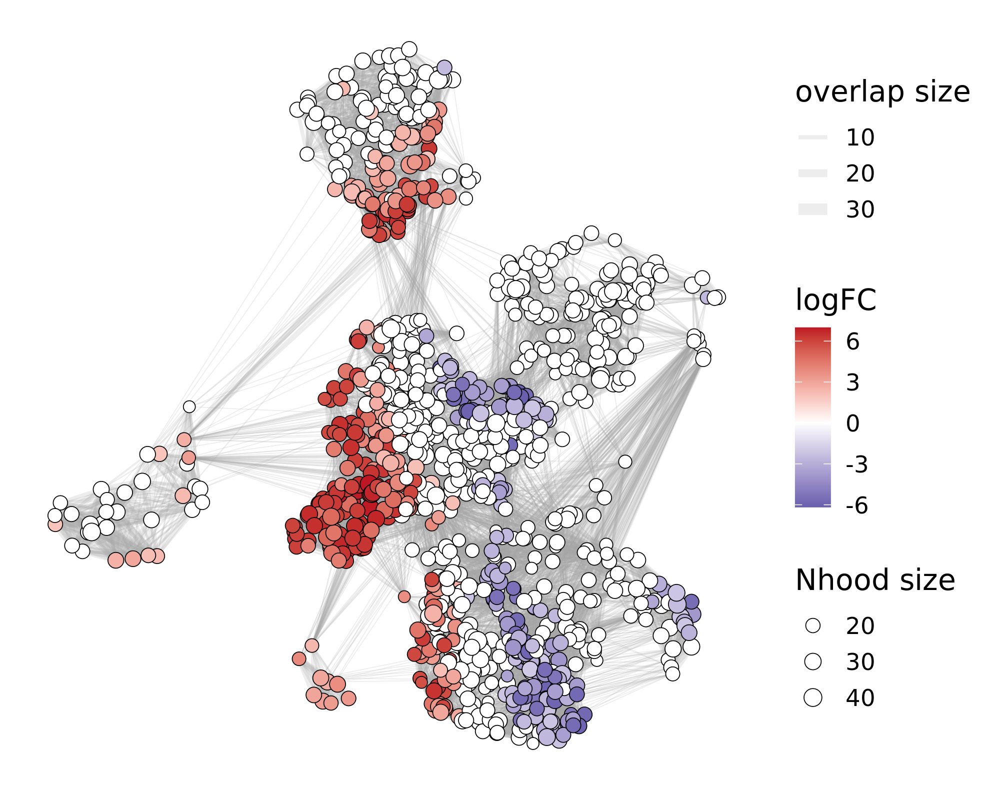

In [21]:
%%R -w 2000 -h 1600 -r 300
set.seed(0)
library(ggplot2)

plotNhoodGraphDA(milo, DA_results_Prox_vs_Dist,  alpha=.1,size_range=c(2.5,4)) +
  scale_fill_gradient2(high='#be1622', mid='white', low="#534ca3", name="logFC")+ theme(
  panel.background = element_rect(fill = "transparent",
                                  colour = NA_character_), # necessary to avoid drawing panel outline
  panel.grid.major = element_blank(), # get rid of major grid
  panel.grid.minor = element_blank(), # get rid of minor grid
  plot.background = element_rect(fill = "transparent",
                                 colour = NA_character_), # necessary to avoid drawing plot outline
  legend.background = element_rect(fill = "transparent"),
)





In [23]:
%%R -i figDir
ggsave(
  paste0(figDir,"/DA_Proximal_vs_Distal.pdf"),
  plot = last_plot(),
  device = "pdf",bg = "transparent",
  scale = 1,
  width = 2200,
  height = 1640,
  units = c("p"),
  dpi = 300)